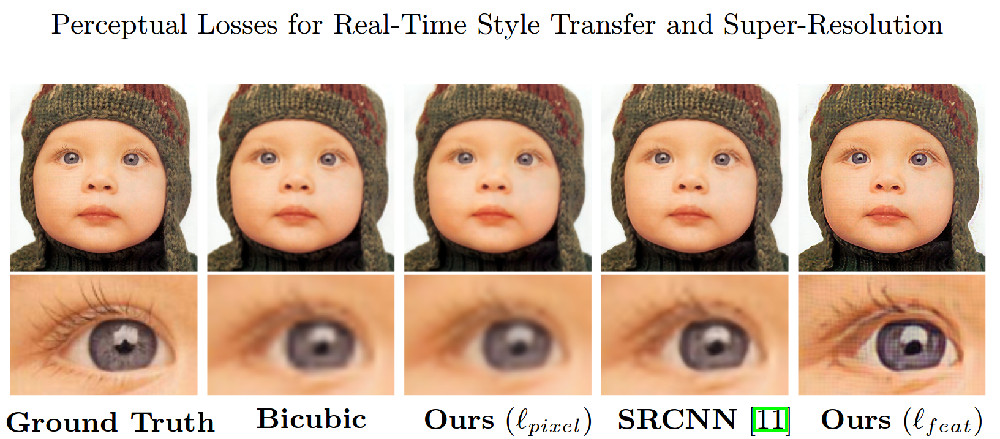

### Small detour for linking to style transfer meetup: Going from single image style transfer to fast style transfer & super-resolution via image transformation network


Style transfer as an optimization problem
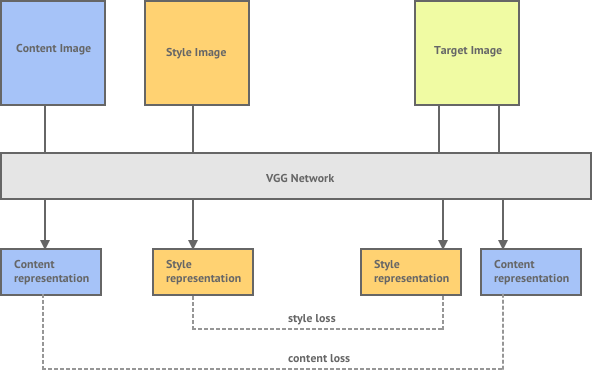

Style transfer using image transformer network
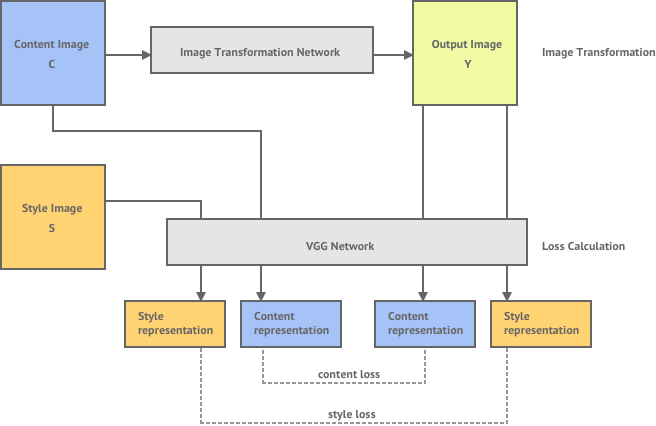

Super resolution using image transformer network
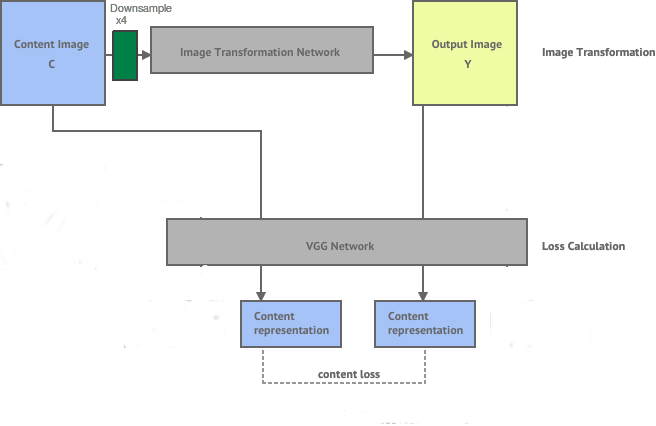

# Framework setup


This notebook contains implementation of a super-resolution network trained on a small Imagenet subset

Dataset provided in the fast.ai v1 course material in bcolz arrays format:
    http://files.fast.ai/data/trn_resized_288.tar.gz
    http://files.fast.ai/data/trn_resized_72.tar.gz
Dataset unpacked to png files available from my gdrive until I find a better place : https://drive.google.com/open?id=1g-KNAbGoTOYeb0fZp6HyxRf4TZH6qPHt


In [1]:
%matplotlib inline
import keras
from keras.layers import Conv2D, BatchNormalization, Activation, Input, Lambda, UpSampling2D, add
from keras.models import Model
from keras.preprocessing.image import ImageDataGenerator
import numpy as np
import PIL.Image as Image
import matplotlib.pyplot as plt
import keras.backend as K

# plot model graph 
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot

Using TensorFlow backend.


In [2]:
def limit_mem():
    K.get_session().close()
    cfg = K.tf.ConfigProto()
    cfg.gpu_options.allow_growth = True
    K.set_session(K.tf.Session(config=cfg))
limit_mem()

In [3]:
#PARAMETERS definition

# imagenet subset
in_size   = 72 # input image size
up_factor = 4  # upscale factor of the image transformation network
bs = 8 # batch size - this is dependent on the GPU memory available, might need to find via trial and error
datapath = './imagenet_subset/train/'

# amazon data
#in_size   = 64 # input image size
#up_factor = 4  # upscale factor of the image transformation network
#bs = 8 # batch size
#datapath = './understanding_amazon_from_space/train-jpg/'

#chest xray data
#in_size   = 128 # input image size
#up_factor = 4  # upscale factor of the image transformation network
#bs = 4 # batch size
#datapath = './chest_xray/chest_xray/train/'

# Build image transformation network model 

Image transformer network
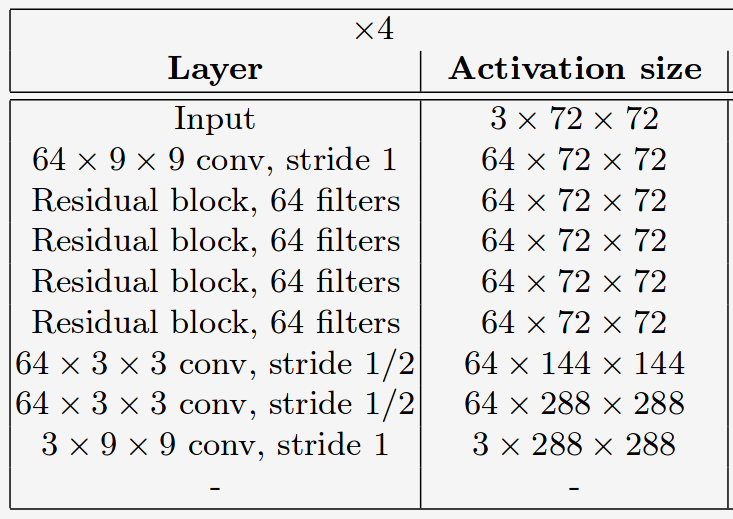

conv with mode = 'same'
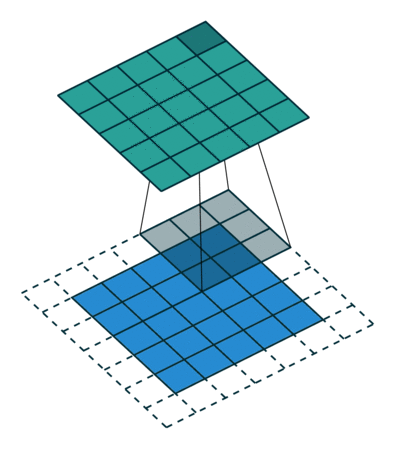

In [4]:
# -> conv2d -> BN -> relu
# OR
# -> conv2d -> BN

def conv_block(x, filters, size, stride=(2,2), mode='same', act=True):
    x = Conv2D(filters, (size, size), strides=stride, padding=mode)(x)
    x = BatchNormalization()(x)
    return Activation('relu')(x) if act else x

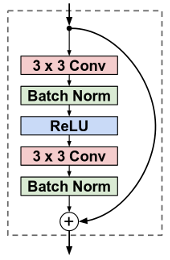

In [5]:
# -> conv2d -> BN -> relu -> conv2d -> BN -> add
#   \________________________________________/

def res_block(ip, nf=64):
    x = conv_block(ip, nf, 3, (1,1))
    x = conv_block(x, nf, 3, (1,1), act=False)
    return add([x, ip])

deconv (fractionaly strided conv with stride 1/2)
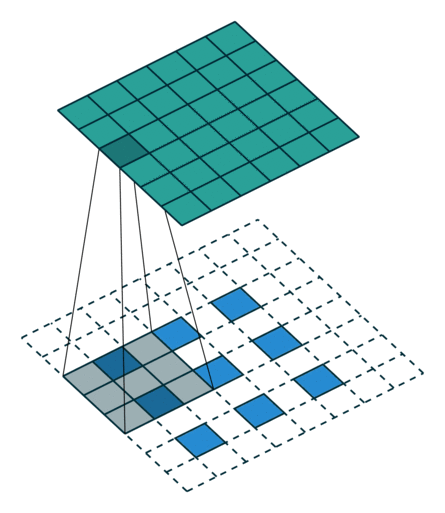

In [6]:
# -> upsample -> conv2d -> BN -> relu
# replaces the original deconvolution block, based on results from https://distill.pub/2016/deconv-checkerboard/
def up_block(x, filters, size):
    x = keras.layers.UpSampling2D()(x)
    x = Conv2D(filters, (size, size), padding='same')(x)
    x = BatchNormalization()(x)
    return Activation('relu')(x)

In [7]:
def get_model(arr):
    #model is fully convolutional so we build a model with the input size equal to the input images size
    inp=Input(arr.shape[1:])
    x=conv_block(inp, 64, 9, (1,1))
    for i in range(4): x=res_block(x)
    for i in range(2): x=up_block(x, 64, 3)
    x=Conv2D(3, (9, 9), activation='tanh', padding='same')(x)
    #map the tanh output [-1,1] to [0,255]
    outp=Lambda(lambda x: (x+1)*127.5)(x)
    return inp, outp

In [8]:
# create dummy arrays of how the low res and high res image batches should look; easier to modify code if switching to bcolz arrays
dummy_lr = np.zeros((1, in_size, in_size, 3))
dummy_hr = np.zeros((1, in_size*up_factor, in_size*up_factor, 3))
inp, outp = get_model(dummy_lr)

# Build VGG bassed training framework

In [9]:
# per channel mean of the imagenet dataset on which the VGG16 we use was pretrained on
imagenet_mean = np.array([123.68, 116.779, 103.939], dtype=np.float32)
# preprocessing data : subtract mean from each channel component ; convert BGR to RGB
preproc = lambda x: (x - imagenet_mean)[:, :, :, ::-1]

In [10]:
# input to the VGG part of the model should have the shape of the high resolution ground truth images
vgg_in_shp = dummy_hr.shape[1:]

# instantiate VGG16 model including the pre-processing required 
vgg_inp = Input(vgg_in_shp)
vgg = keras.applications.VGG16(include_top=False, input_tensor=Lambda(preproc)(vgg_inp))
# we only use the VGG16 part for perceptual loss and do not want to change its weight so freeze it!
for l in vgg.layers: l.trainable=False
vgg.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 288, 288, 3)       0         
_________________________________________________________________
lambda_2 (Lambda)            (None, 288, 288, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 288, 288, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 288, 288, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 144, 144, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 144, 144, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 144, 144, 128)     147584    
__________

In [11]:
# we want to use the output of multiple layers of VGG for content loss calculation
content_layers = ["block1_conv2", 
                  "block2_conv2", 
                  "block3_conv2"]
# extracts the output values of a layer named lname from model m
def get_outp(m, lname): return m.get_layer(lname).output

vgg_content = Model(vgg_inp, [get_outp(vgg, o) for o in content_layers])
vgg_ground_truth  = vgg_content(vgg_inp)
vgg_reconstructed = vgg_content(outp)

In [12]:
def mean_sqr_b(diff): 
    dims = list(range(1,K.ndim(diff)))
    return K.expand_dims(K.sqrt(K.mean(diff**2, dims)), -1)

In [13]:
w=[0.1, 0.8, 0.1]
def content_cost(x): 
    res = 0; n=len(w)
    for i in range(n): res += mean_sqr_b(x[i]-x[i+n]) * w[i]
    return res

In [14]:
m_sr = Model([inp, vgg_inp], Lambda(content_cost)(vgg_ground_truth+vgg_reconstructed))
m_sr.compile(optimizer='adam', loss='mae')
#bm_sr.summary()

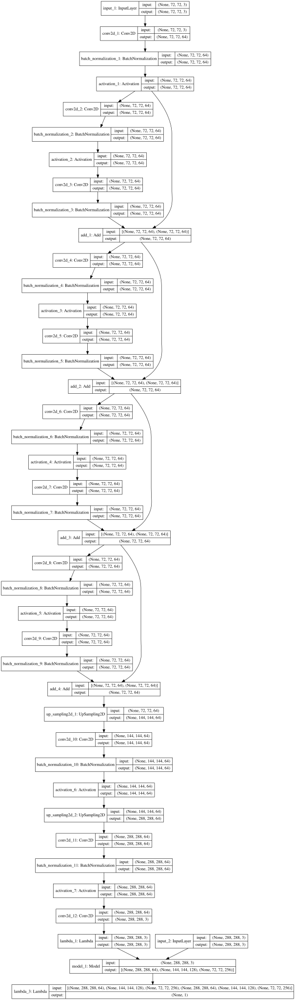

In [15]:
SVG(model_to_dot(m_sr,show_shapes=True).create(prog='dot', format='svg'))

# Training data setup 

In [16]:
# generator code based on keras example :
#https://keras.io/preprocessing/image/#image-preprocessing

# we create two instances with the same arguments
data_gen_args = dict(horizontal_flip = True,
                     vertical_flip   = True
                    )
image_hr_datagen = ImageDataGenerator(**data_gen_args)
image_lr_datagen = ImageDataGenerator(**data_gen_args)

# Provide the same seed and keyword arguments to the flow methods
seed = 42

image_hr_generator = image_hr_datagen.flow_from_directory(
    datapath,
    target_size=(in_size*up_factor, in_size*up_factor), #this is the output size of the image transformation network & ground truth
    class_mode=None,
    batch_size=bs,
    seed=seed)

image_lr_generator = image_lr_datagen.flow_from_directory(
    datapath,
    target_size=(in_size, in_size), # this will be the input size to our transformer network (x4 downsample)
    class_mode=None,
    batch_size=bs,
    seed=seed)
        
# combine generators into one which yields low res and high res images
train_generator = zip(image_lr_generator, image_hr_generator)


Found 19439 images belonging to 1 classes.
Found 19439 images belonging to 1 classes.


# Train model 

We're unable to use <tt>model.fit_generator()</tt> because that function call expects the generator to return a tuple of inputs and targets.

Our generator however yields two inputs. We can work around this by separately pulling out our inputs from the generator and then using <tt>model.train_on_batch()</tt> with our inputs from the generator and our dummy targets. <tt>model.train_on_batch()</tt> simply does one gradient update on the batch of data.

This technique of creating your own training loop is useful when you are working with various iterators or complicated inputs that don't conform to keras' standard fitting methods.

In [17]:
def train(bs, niter=10):
    # we need a target that has a single 0 value for each sample in the batch
    targ = np.zeros((bs,1))
    for i in range(niter):
        lr,hr = next(train_generator)
        batch_loss = m_sr.train_on_batch([lr[:bs], hr[:bs]], targ)
        loss_run_avg = (0.95*loss_run_avg + 0.05*batch_loss) if i>0 else batch_loss
        if i%100==99 :
            print('Current loss at ',i,' iterations : ',loss_run_avg)
    print('Final loss: ',loss_run_avg)

In [18]:
its = image_hr_generator.n//bs; its

2429

### train for a few epochs 

In [22]:
%time train(bs, its)

Current loss at  99  iterations :  273.111050297
Current loss at  199  iterations :  239.811386006
Current loss at  299  iterations :  217.036656864
Current loss at  399  iterations :  211.530015981
Current loss at  499  iterations :  206.719162634
Current loss at  599  iterations :  198.641002811
Current loss at  699  iterations :  191.491874738
Current loss at  799  iterations :  190.998253698
Current loss at  899  iterations :  186.647886397
Current loss at  999  iterations :  191.413274693
Current loss at  1099  iterations :  188.641264033
Current loss at  1199  iterations :  172.009186308
Current loss at  1299  iterations :  169.124197403
Final loss:  169.000038584
CPU times: user 2min 33s, sys: 14.2 s, total: 2min 47s
Wall time: 2min 53s


In [23]:
K.set_value(m_sr.optimizer.lr, 3e-4)
train(bs, its)

Current loss at  99  iterations :  164.335500616
Current loss at  199  iterations :  169.112479624
Current loss at  299  iterations :  169.555136024
Current loss at  399  iterations :  161.713581295
Current loss at  499  iterations :  164.634506386
Current loss at  599  iterations :  164.520985053
Current loss at  699  iterations :  165.162419699
Current loss at  799  iterations :  165.586664129
Current loss at  899  iterations :  158.792395958
Current loss at  999  iterations :  168.10484622
Current loss at  1099  iterations :  161.009036386
Current loss at  1199  iterations :  166.111441807
Current loss at  1299  iterations :  161.901506951
Final loss:  159.813218594


In [24]:
K.set_value(m_sr.optimizer.lr, 1e-4)
train(bs, its)

Current loss at  99  iterations :  162.83857256
Current loss at  199  iterations :  162.432222222
Current loss at  299  iterations :  162.669473714
Current loss at  399  iterations :  161.593683769
Current loss at  499  iterations :  158.310820945
Current loss at  599  iterations :  157.202181244
Current loss at  699  iterations :  157.852344578
Current loss at  799  iterations :  162.985543159
Current loss at  899  iterations :  158.083454669
Current loss at  999  iterations :  158.677554864
Current loss at  1099  iterations :  159.381906411
Current loss at  1199  iterations :  159.293630417
Current loss at  1299  iterations :  162.85388558
Final loss:  160.221531795


In [19]:
top_model = Model(inp, outp)

# Test model

In [50]:
fig_size=16
def test_sr(model, test_img, in_size):
    # load, convert to RGB just in case & resize test image
    img = Image.open(test_img).convert('RGB').resize((in_size,in_size),resample=Image.LANCZOS)
    # build model input tensor, need to add batches axis to dimension 0 of the image
    img_dat = np.expand_dims(np.array(img),0)
    
    # plot model input
    plt.figure(figsize=(fig_size,fig_size))
    plt.title('ORIGINAL IMAGE LOW RES')
    plt.imshow(img_dat[0]);
    
    # get & plot output of superresolution model
    p = model.predict(img_dat)
    #plot 
    plt.figure(figsize=(fig_size,fig_size))
    plt.title('SUPERRESOLUTION')
    plt.imshow(p[0].astype('uint8')); # output will be in fp format; needs to be explicitly converted to u8
    
    #plot upscaled version (via interpolation) for comparison  
    plt.figure(figsize=(fig_size,fig_size))
    plt.title('BICUBIC INTERPOLATION')
    plt.imshow(img.resize((in_size*up_factor,in_size*up_factor),resample=Image.LANCZOS))

In [21]:
# build a low res to high res model
test_model = Model(inp,outp)
test_model.load_weights('./sr_v2_4*1214iter.h5')

In [32]:
# build a high res to higher res model
inp_hr, outp_hr = get_model(dummy_hr)
hr_test_model = Model(inp_hr,outp_hr)
hr_test_model.load_weights('./sr_v2_4*1214iter.h5')

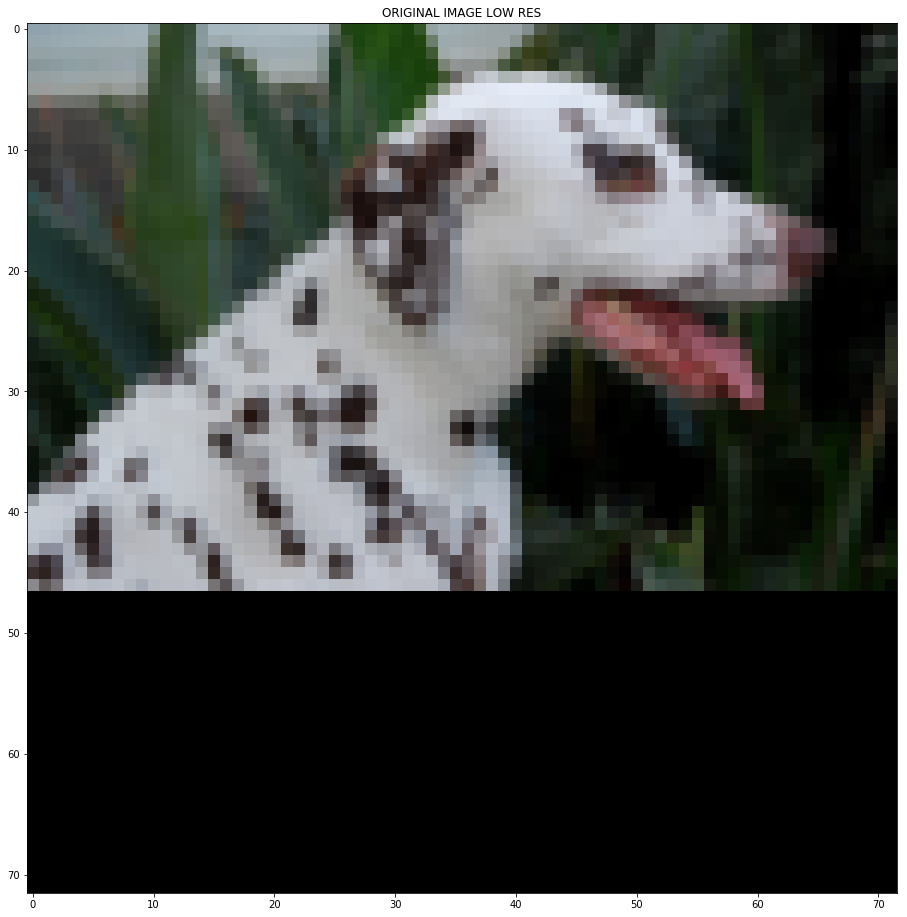

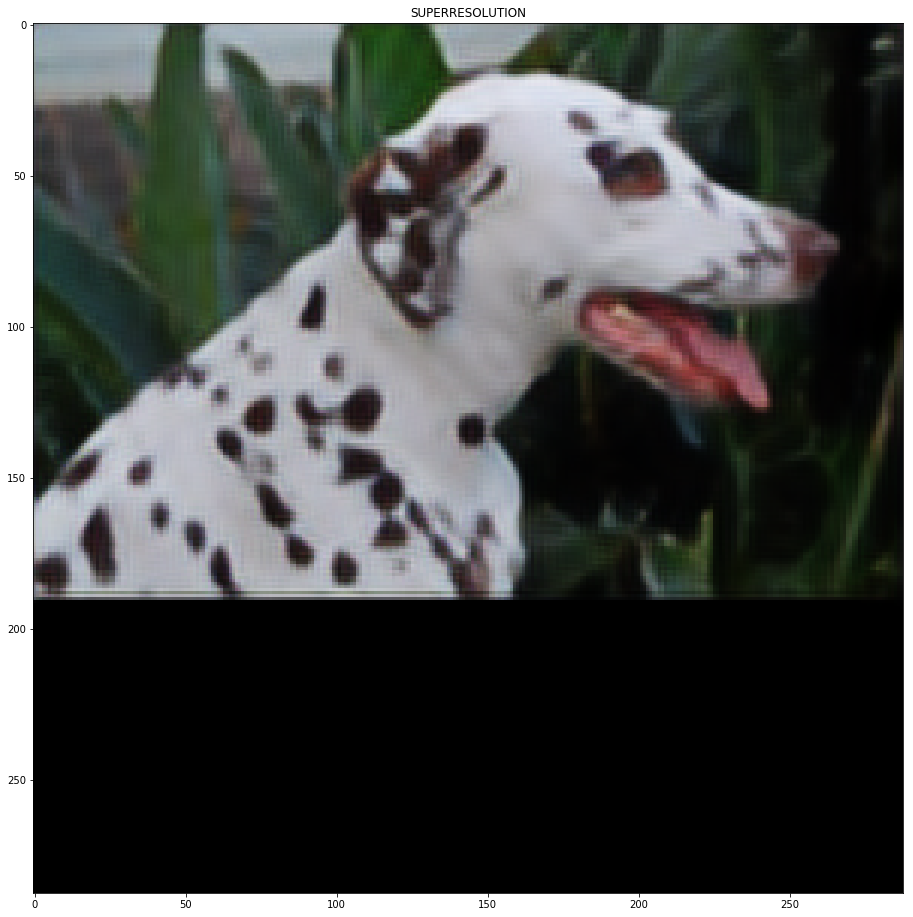

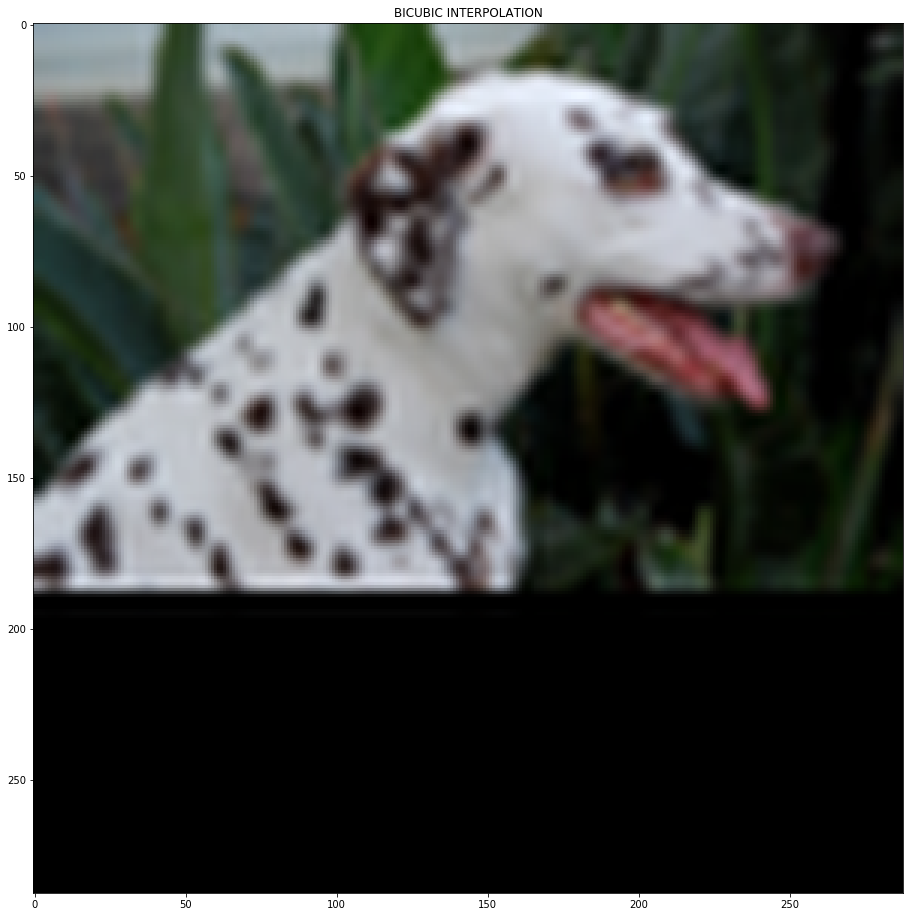

In [51]:
test_sr(test_model, './imagenet_subset/lr/img_1002.png', in_size)

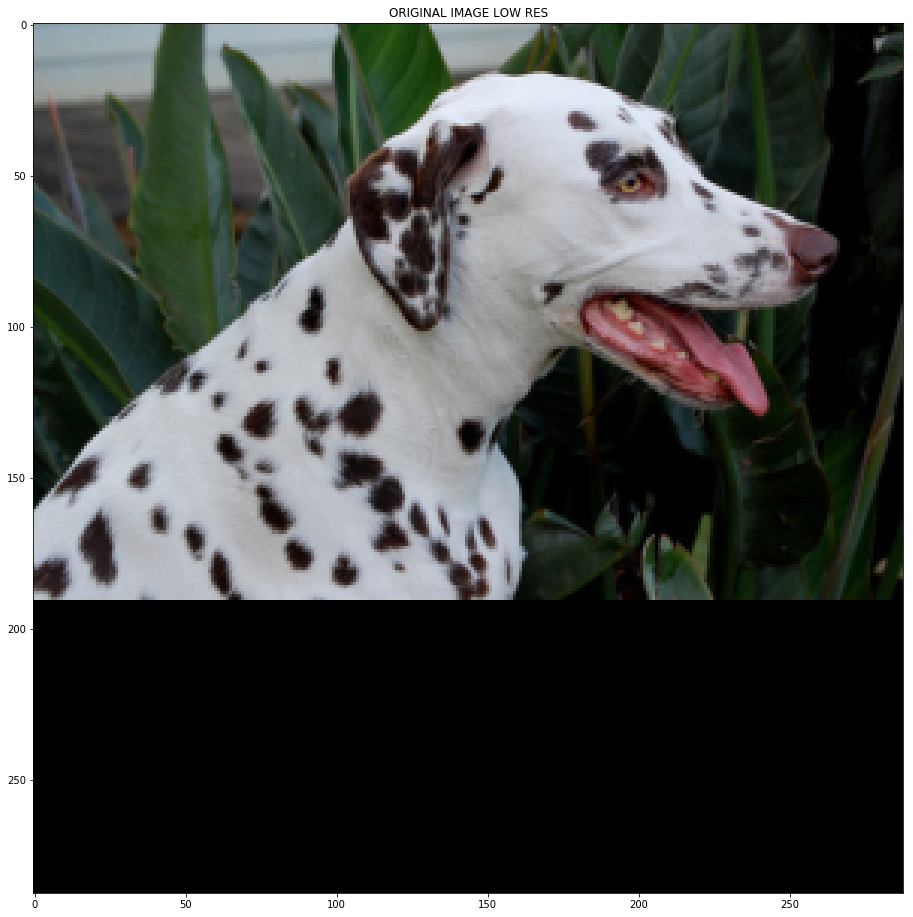

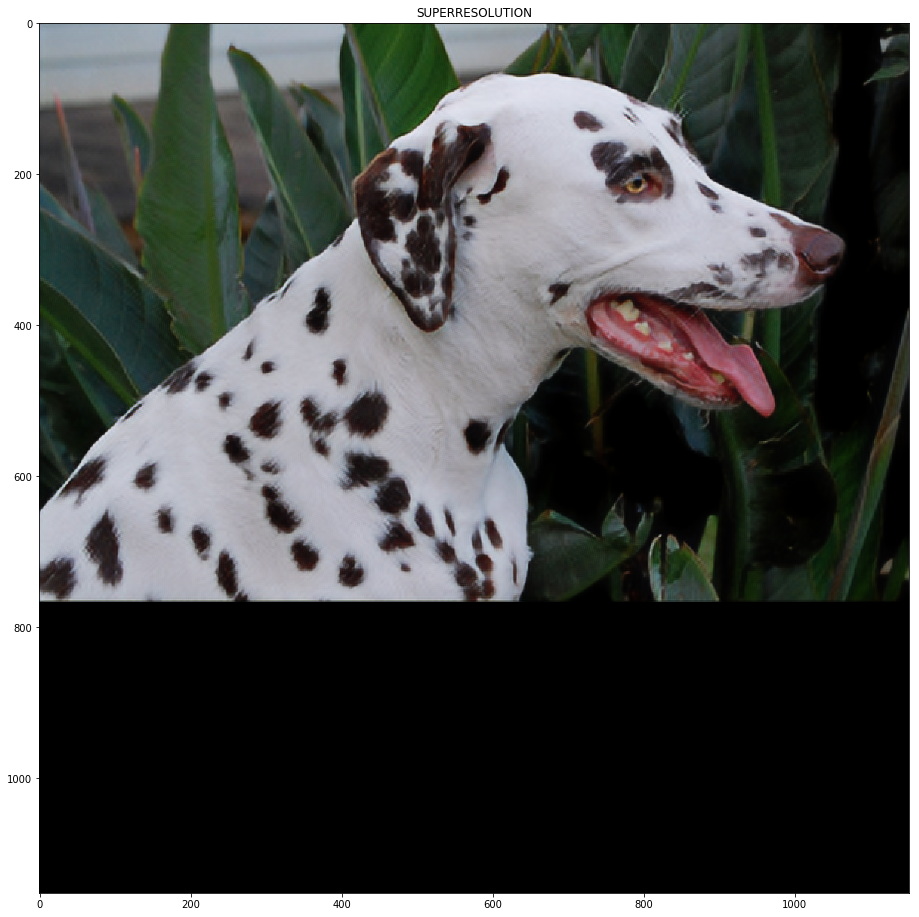

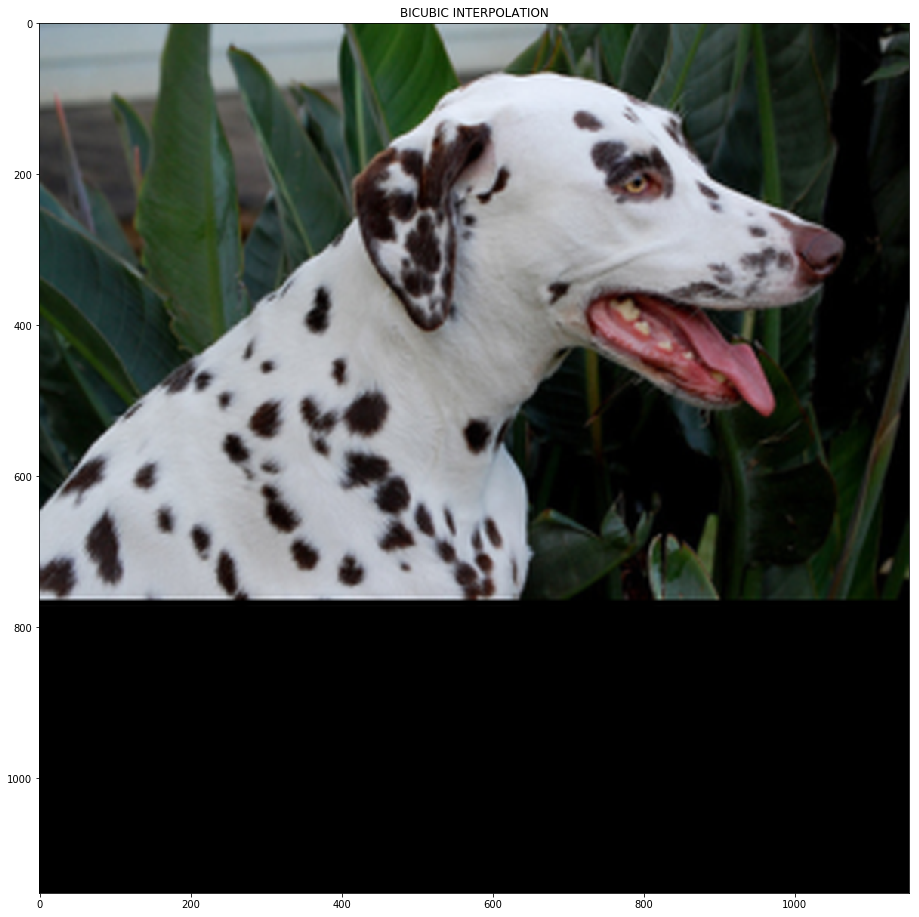

In [52]:
test_sr(hr_test_model, './imagenet_subset/train/hr/img_1002.png',in_size*up_factor)

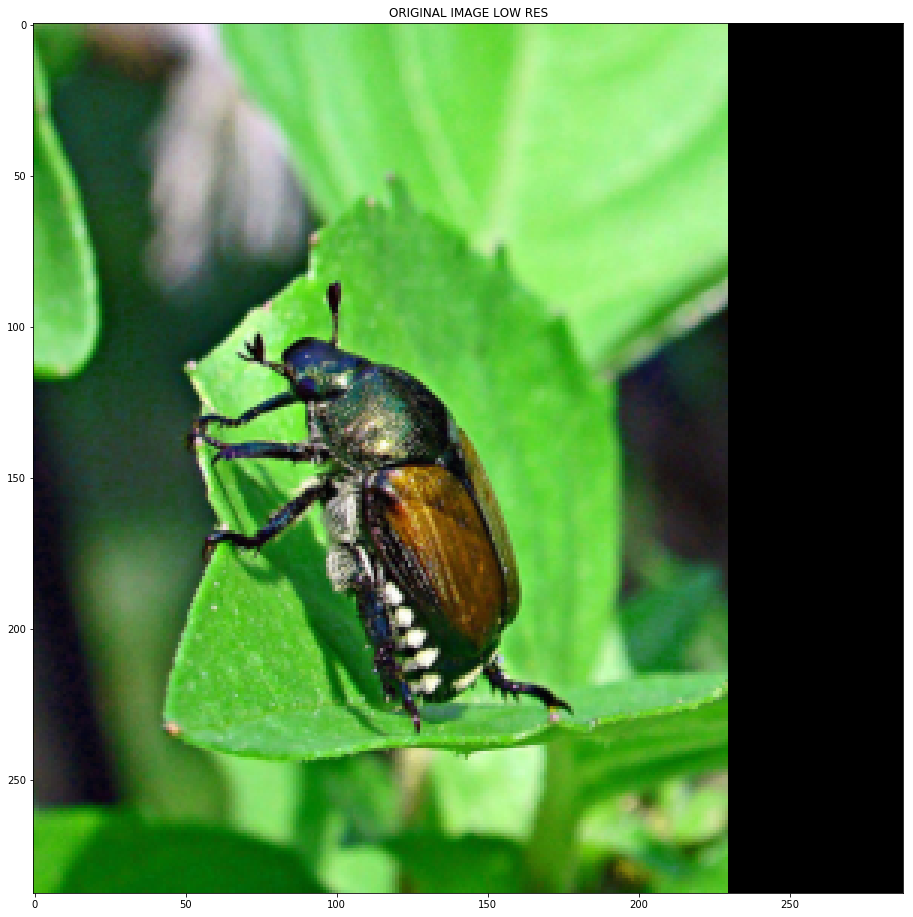

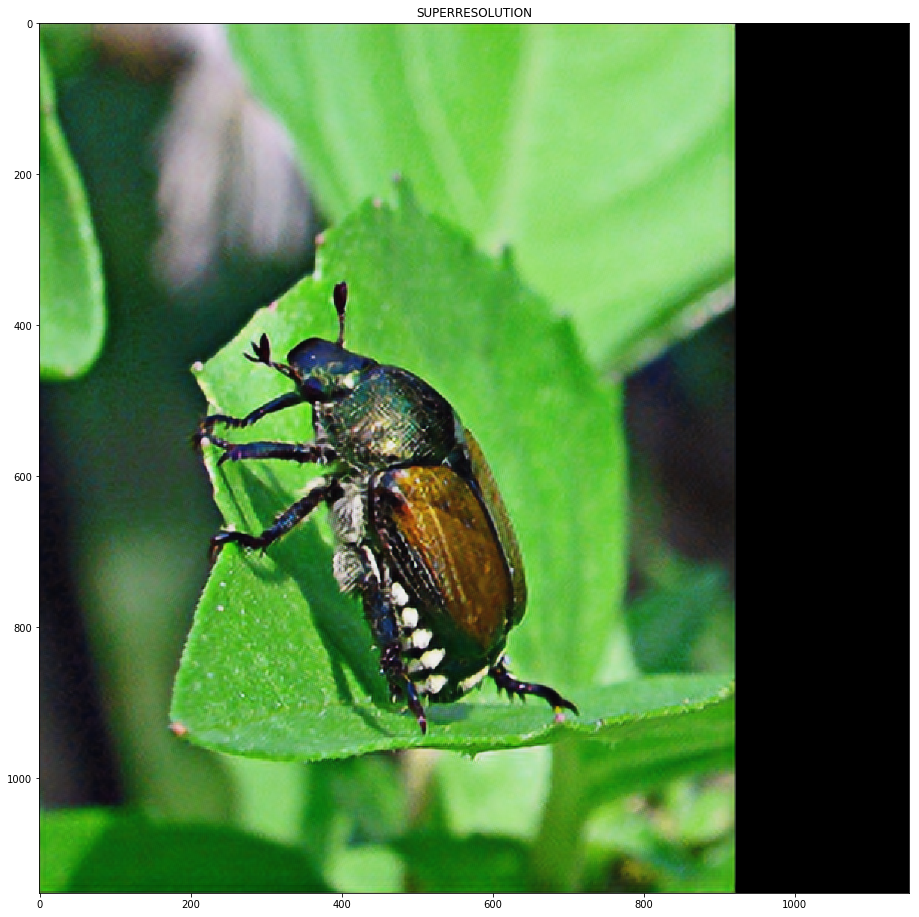

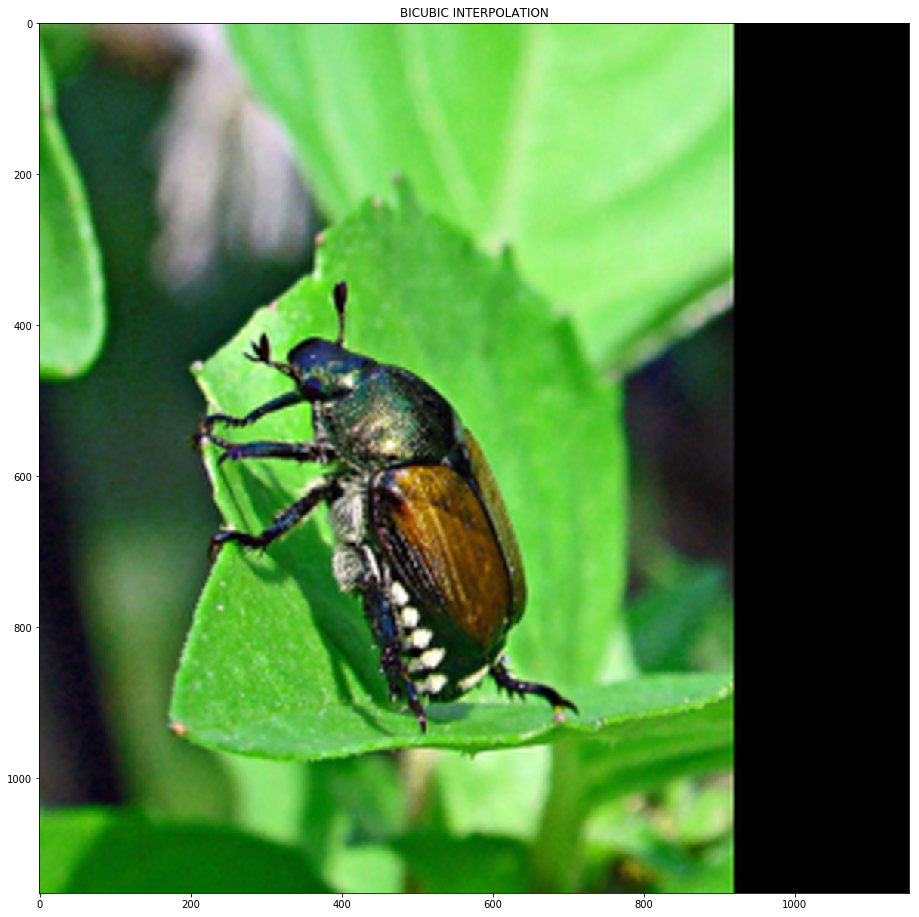

In [53]:
test_sr(hr_test_model, './imagenet_subset/train/hr/img_2001.png',in_size*up_factor)

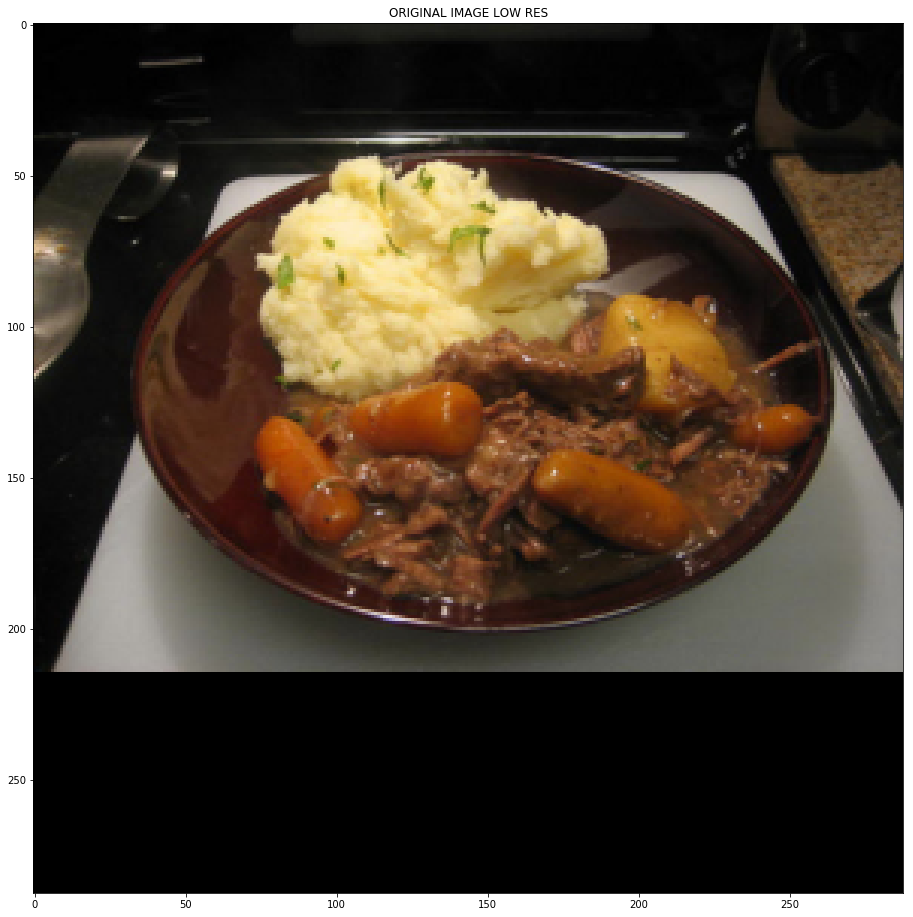

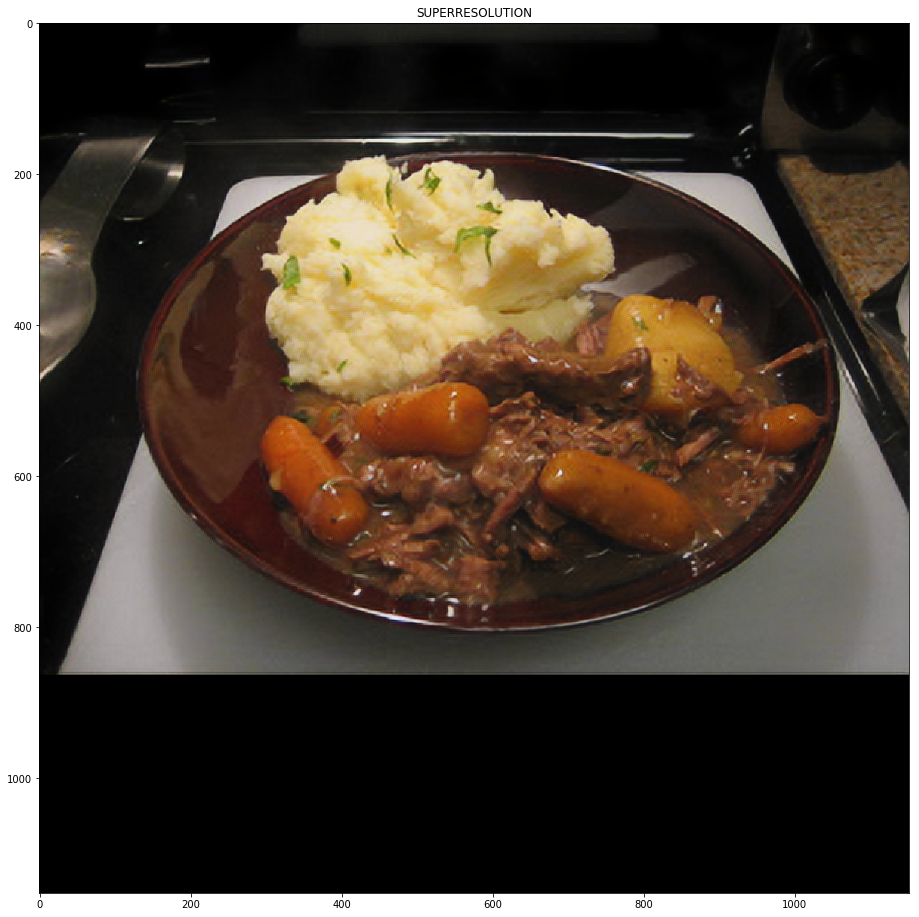

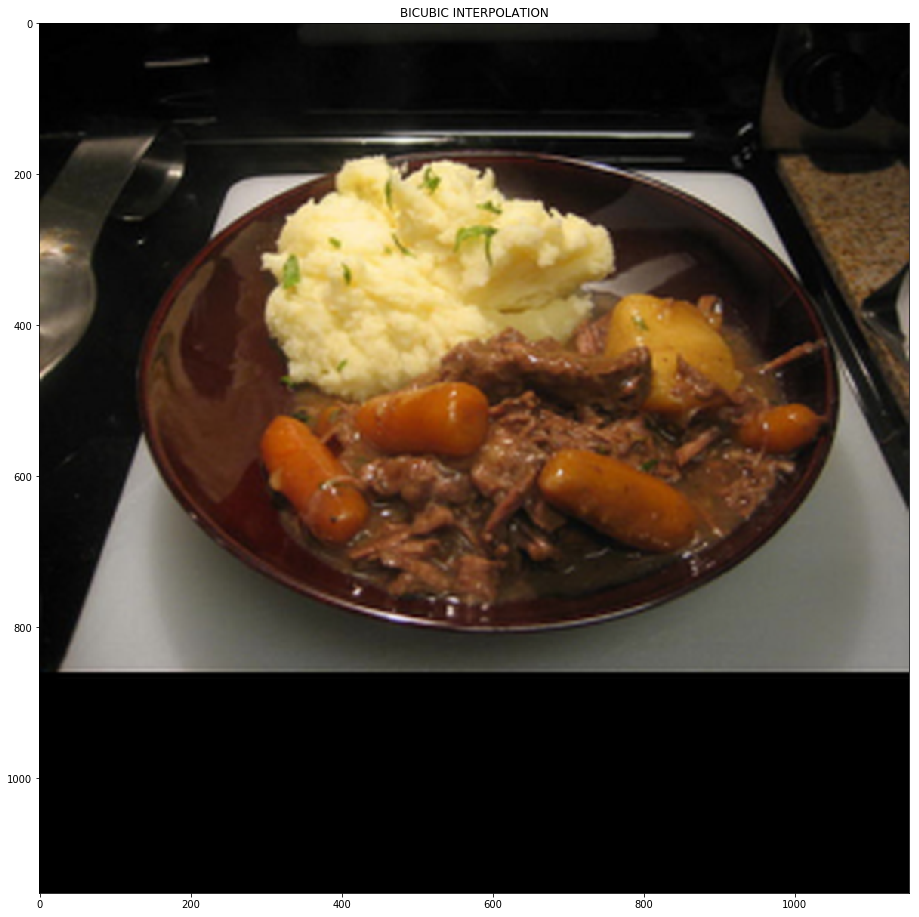

In [57]:
test_sr(hr_test_model, './imagenet_subset/train/hr/img_7.png',in_size*up_factor)

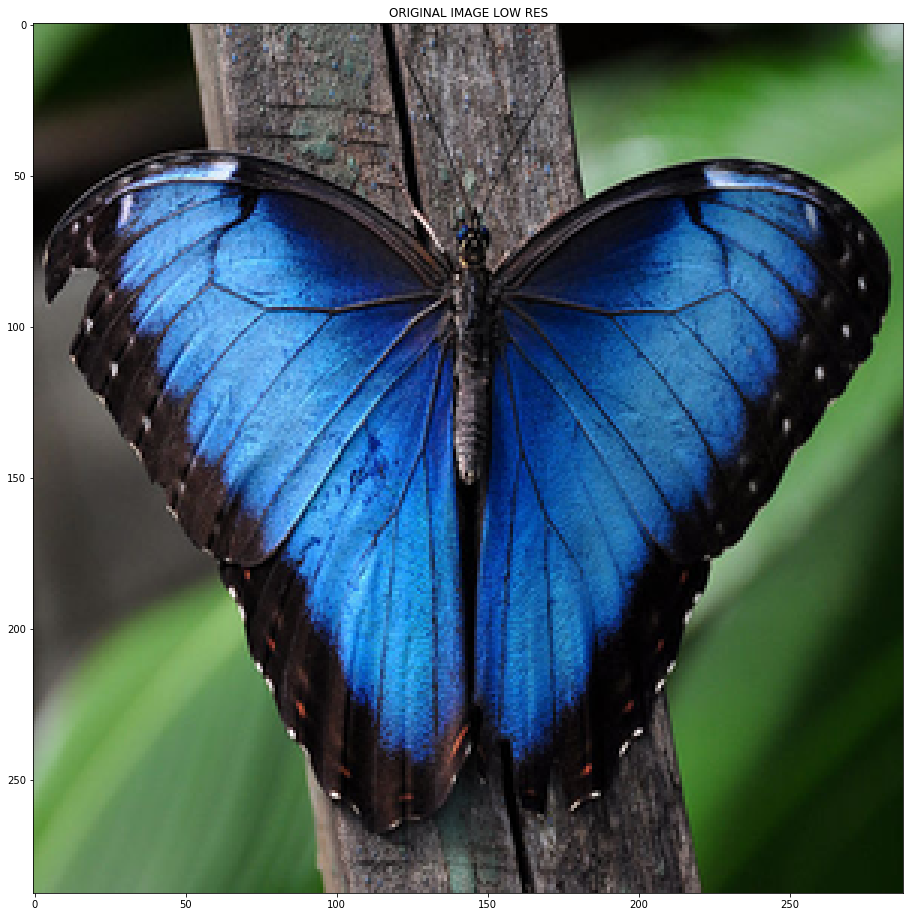

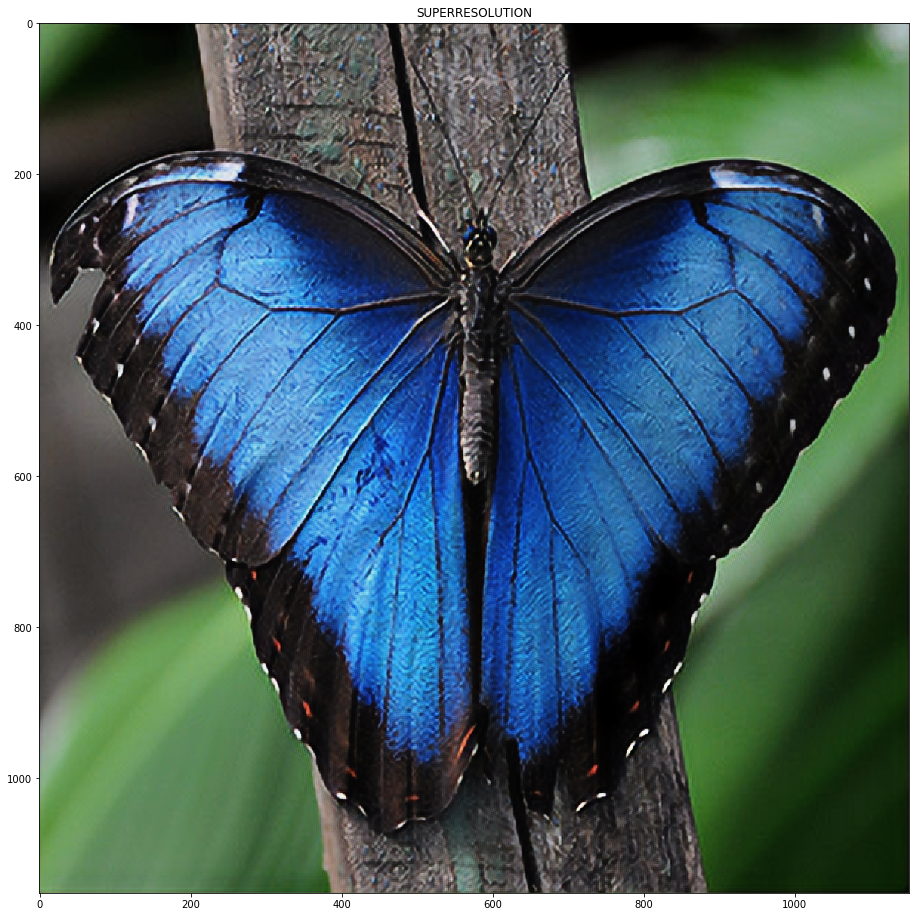

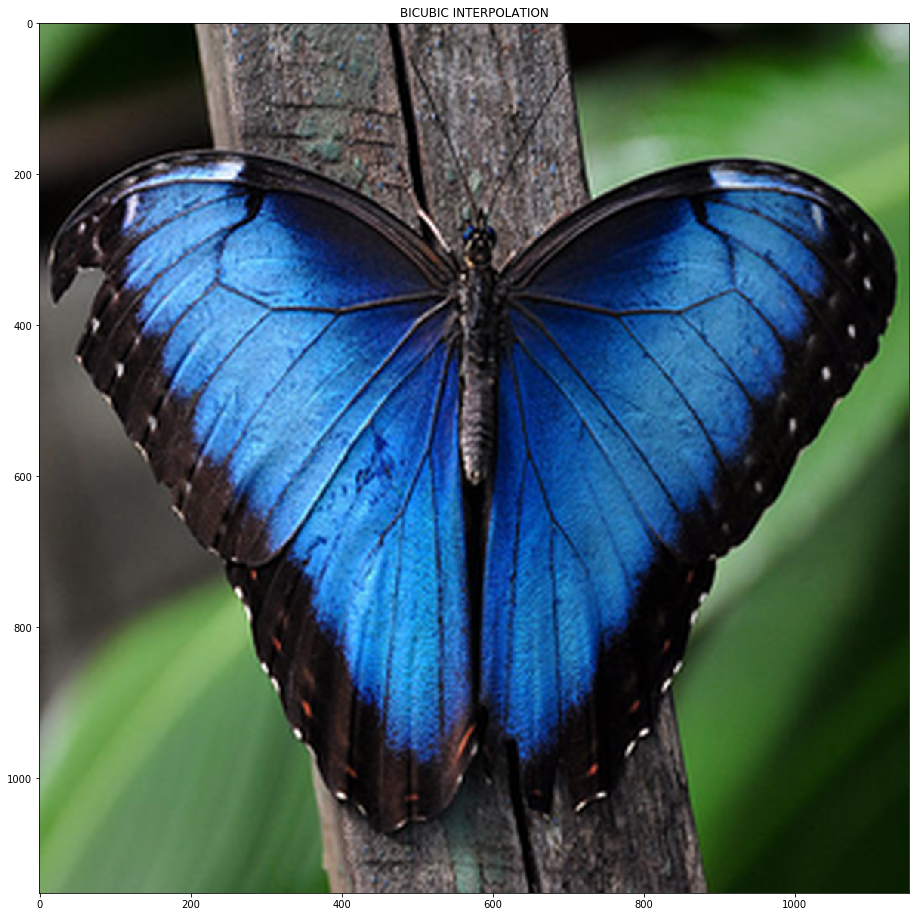

In [59]:
test_sr(hr_test_model, './test_pics/butterfly_blue.jpg',in_size*up_factor)

### imagenet subset model predictions 

In [63]:
p = top_model.predict(arr_lr[1000:1020])

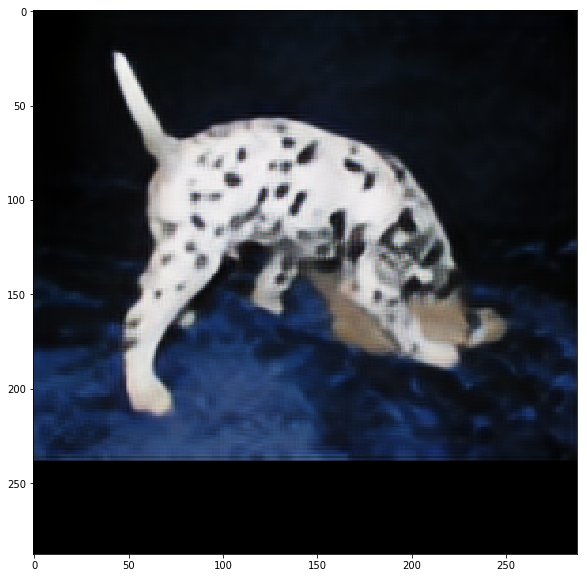

In [65]:
plt.figure(figsize=(10,10))
plt.imshow(p[0].astype('uint8'));

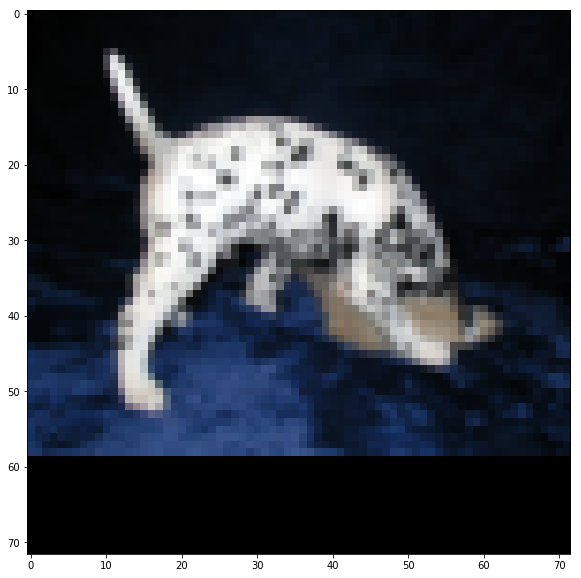

In [67]:
plt.figure(figsize=(10,10))
plt.imshow(arr_lr[1000].astype('uint8'));

In [68]:
src_img = arr_lr[1000]
lr_inter = resize(src_img.astype('uint8'), (src_img.shape[0]*4 , src_img.shape[1]*4))

/home/virgil/.virtualenvs/p3_keras_tf/lib/python3.5/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


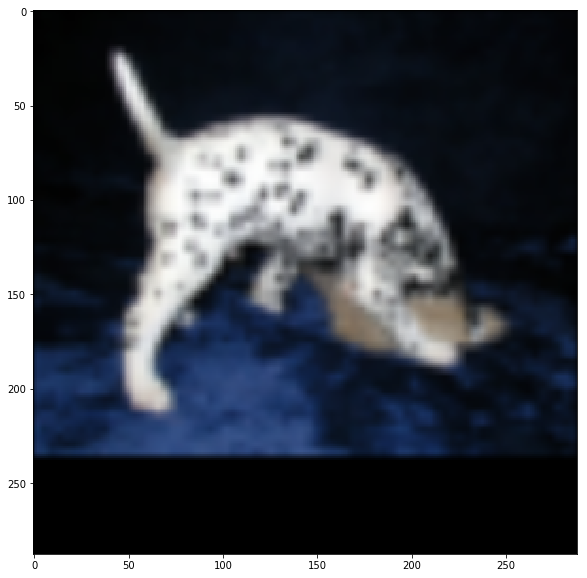

In [69]:
plt.figure(figsize=(10,10))
plt.imshow(lr_inter);

In [55]:
??scipy.misc.imresize

In [110]:
p_hr = model_hr.predict(arr_hr[1002:1003].astype('uint8'))

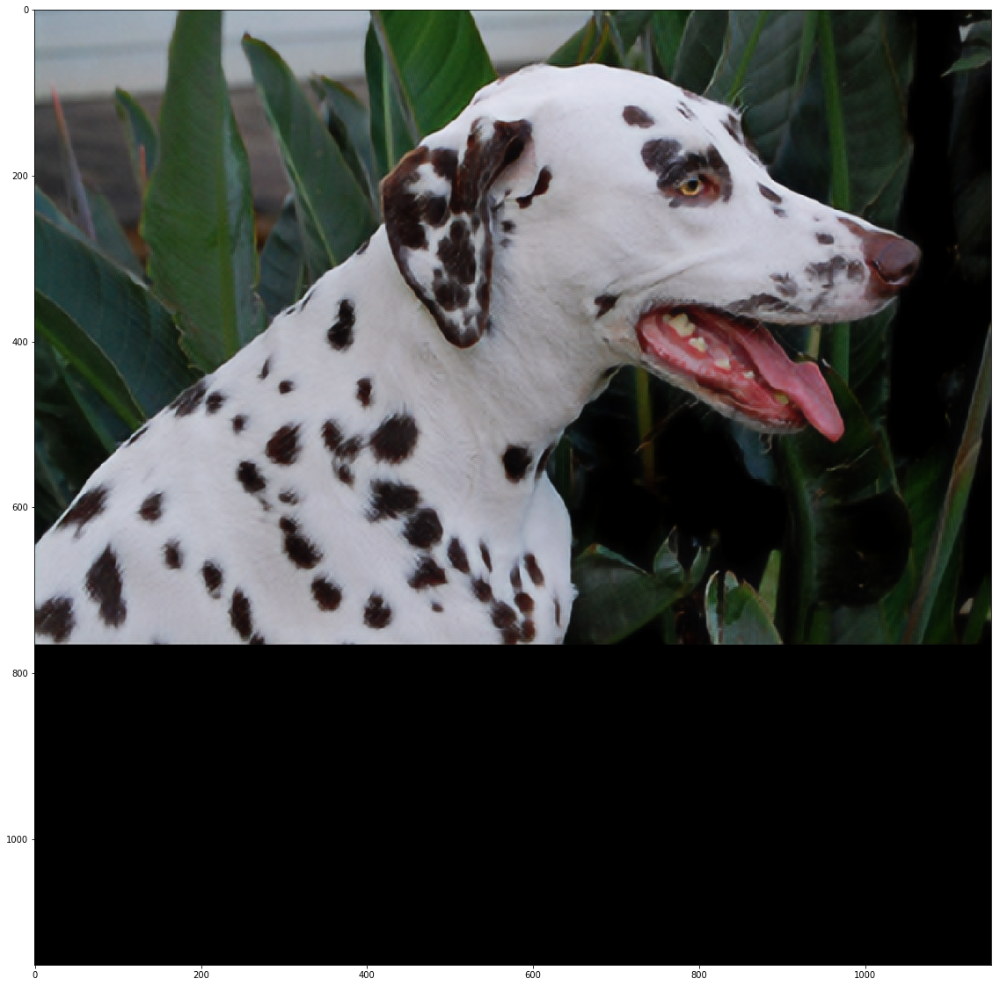

In [111]:
plt.figure(figsize=(20,20))
plt.imshow(p_hr[0].astype('uint8'));

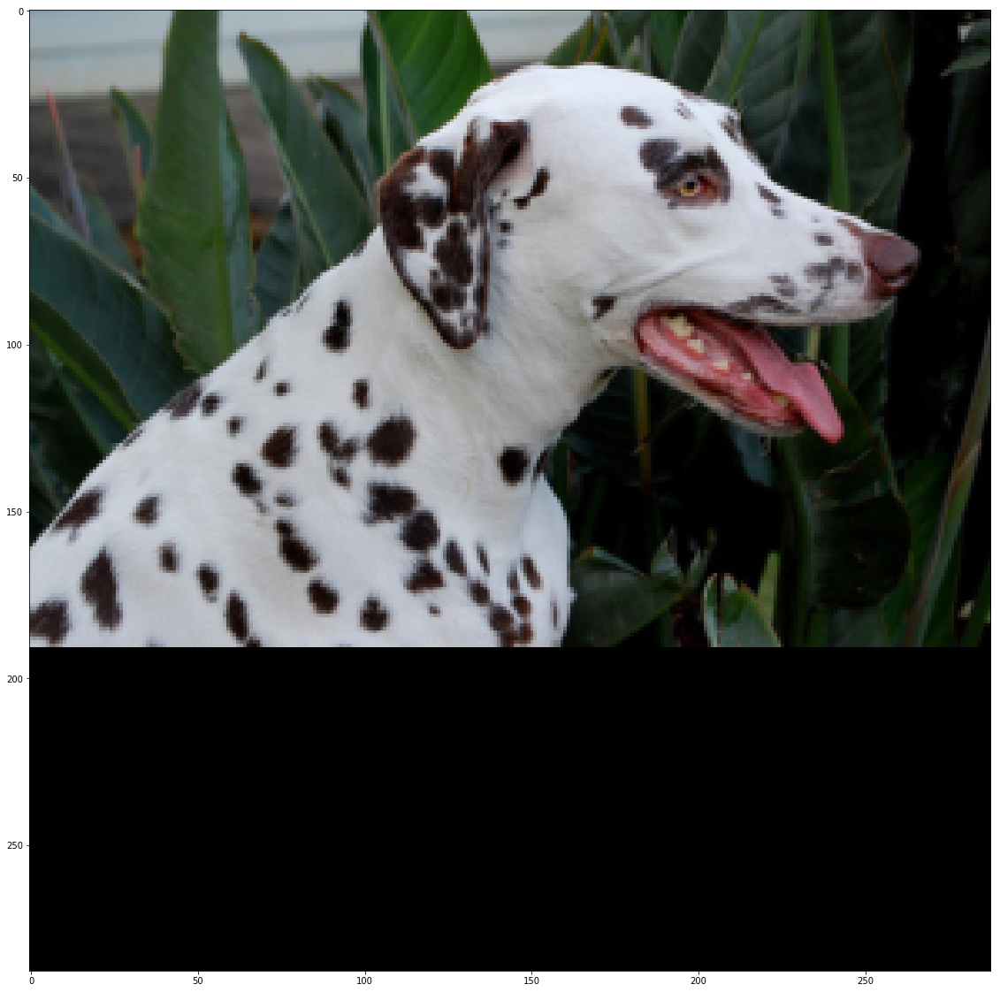

In [113]:
plt.figure(figsize=(20,20))
plt.imshow(arr_hr[1002].astype('uint8'));

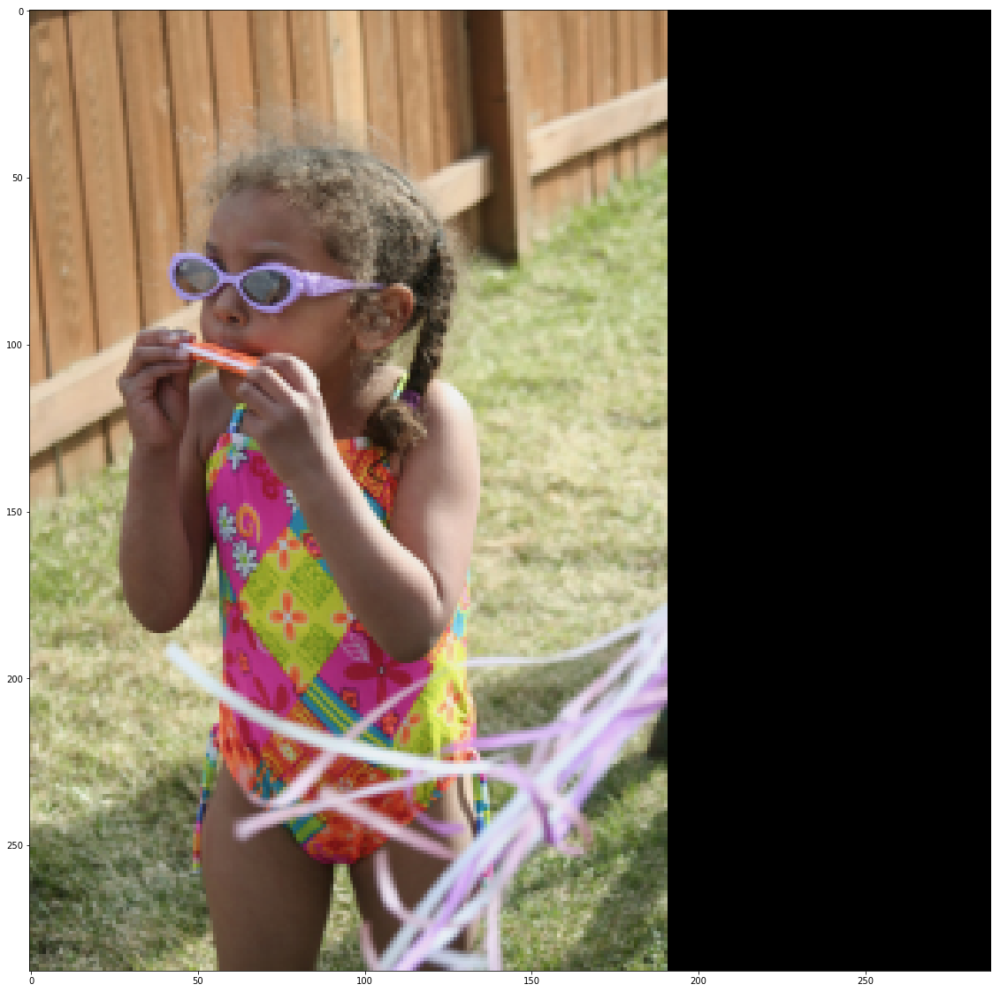

In [135]:
idx = 1750 #1402
plt.figure(figsize=(20,20))
plt.imshow(arr_hr[idx].astype('uint8'));

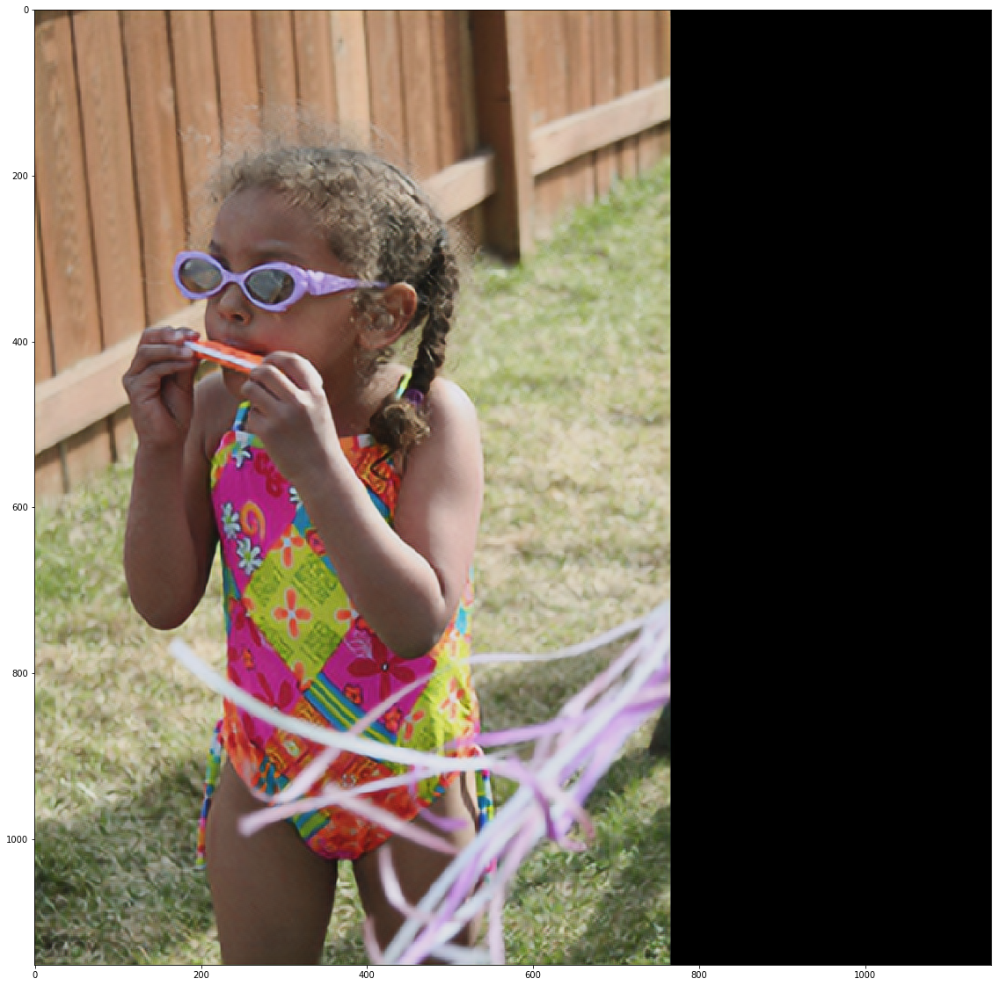

In [136]:
p_hr = model_hr.predict(arr_hr[idx:idx+1].astype('uint8'))
plt.figure(figsize=(20,20))
plt.imshow(p_hr[0].astype('uint8'));

In [87]:
#new_file = '../../../coderepublik/explore/yolo/framework/PersonDetection/yolo_clean/pedestrians.jpg'
new_file = '../fastai_v1_data/pupper.jpg'

In [75]:
img = Image.open(new_file).resize((288,288))

In [76]:
img_dat = np.expand_dims(np.array(img),0)

The model is working as expected.

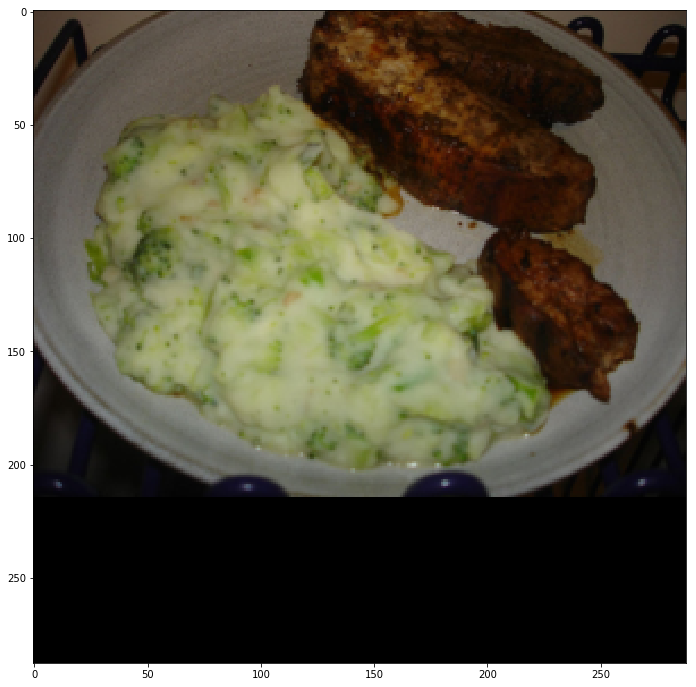

In [41]:
idx=4
plt.figure(figsize=(12,12))
plt.imshow(arr_hr[idx].astype('uint8'));

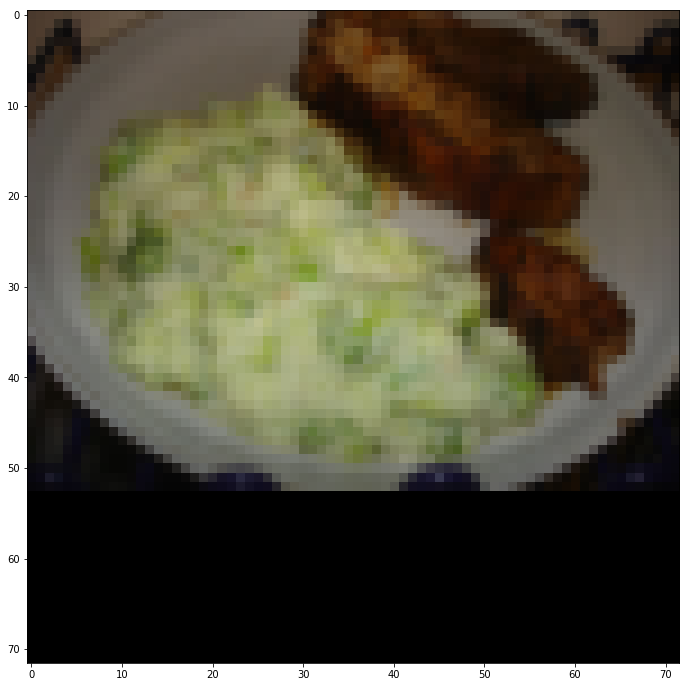

In [44]:
plt.figure(figsize=(12,12))
plt.imshow(arr_lr[idx].astype('uint8'));

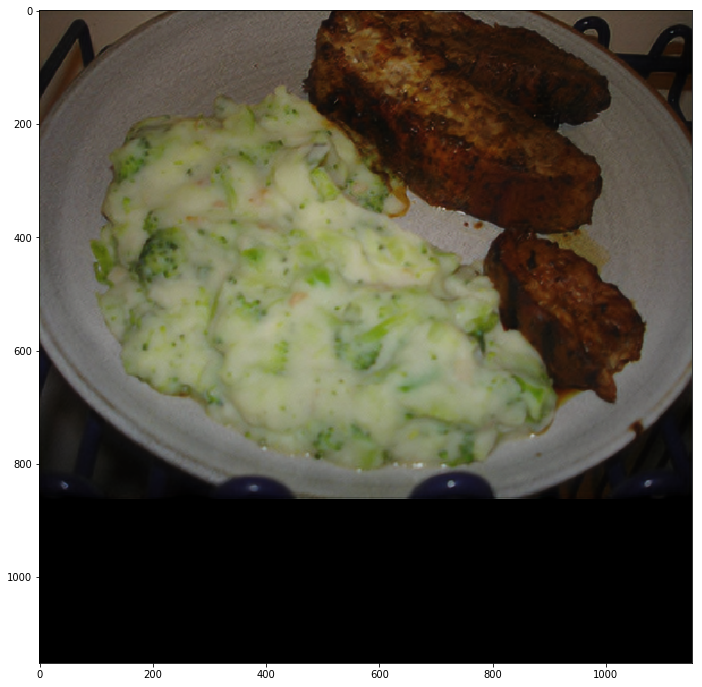

In [47]:
plt.figure(figsize=(12,12))
plt.imshow(p[0].astype('uint8'));

Since the CNN is fully convolutional, we can use it one images of arbitrary size. Let's try it w/ the high-res as the input.

In [38]:
inp,outp=get_model(arr_hr)
model_hr = Model(inp, outp)
copy_weights(top_model.layers, model_hr.layers)

In [43]:
p = model_hr.predict(arr_hr[idx:idx+1])

This quality of this prediction is very impressive given that this model was trained the low res images.

One take away here is that this suggests that the upsampling such a model is learning is somewhat independent of resolution.

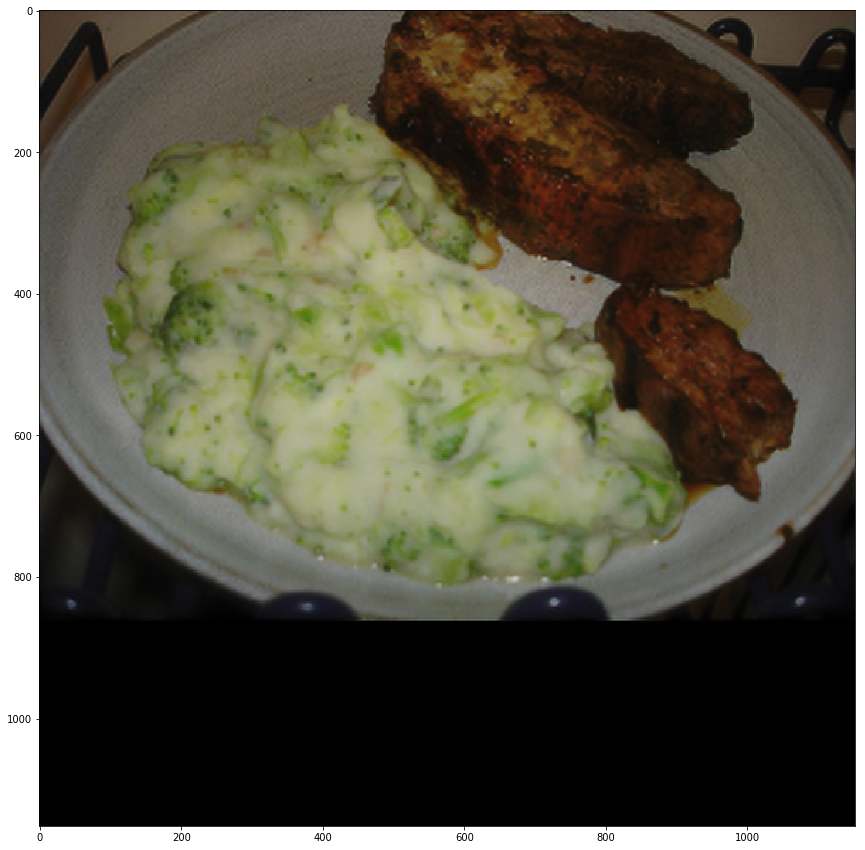

In [72]:
plt.figure(figsize=(15,15))
plt.imshow(p[0].astype('uint8'));

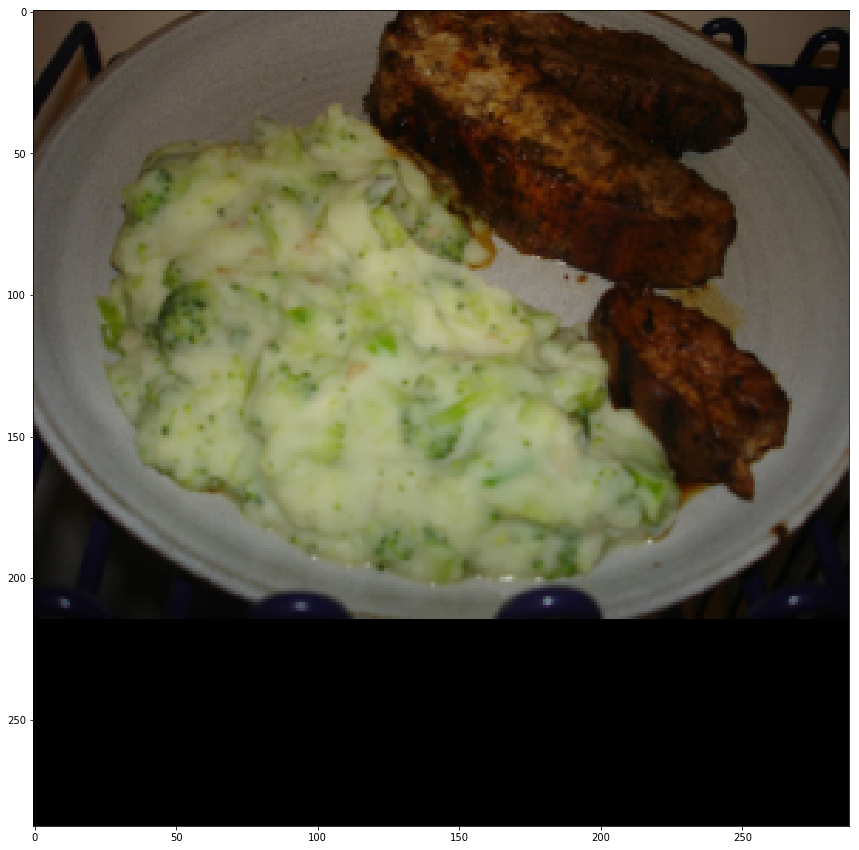

In [73]:
plt.figure(figsize=(15,15))
plt.imshow(arr_hr[idx].astype('uint8'));

In [40]:
top_model.save_weights(dpath+'sr_final.h5')

In [22]:
top_model.load_weights(dpath+'sr_final.h5')

# Scratchpad

In [186]:
new_file = '../../../meetup/2018_06_21_superresolution/old_pics/img1.jpg'

In [187]:
img = Image.open(new_file).resize((128,128),resample=Image.LANCZOS)

In [188]:
img_dat = np.expand_dims(np.array(img),0)

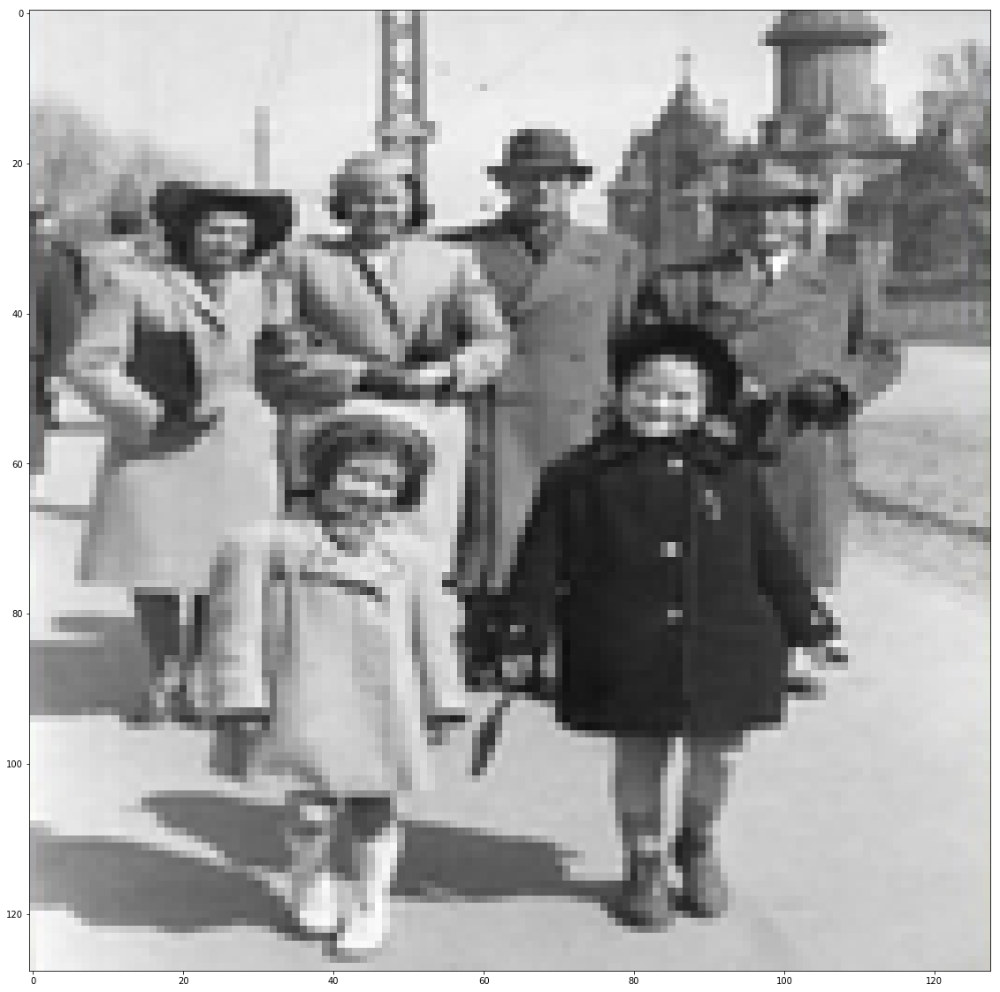

In [189]:
plt.figure(figsize=(20,20))
plt.imshow(img_dat[0]);

In [190]:
inp,outp=get_model(img_dat)
model_test = Model(inp, outp)

In [191]:
model_test.load_weights('./sr_v2_4*1214iter.h5')

In [192]:
p = model_test.predict(img_dat.astype('uint8'))

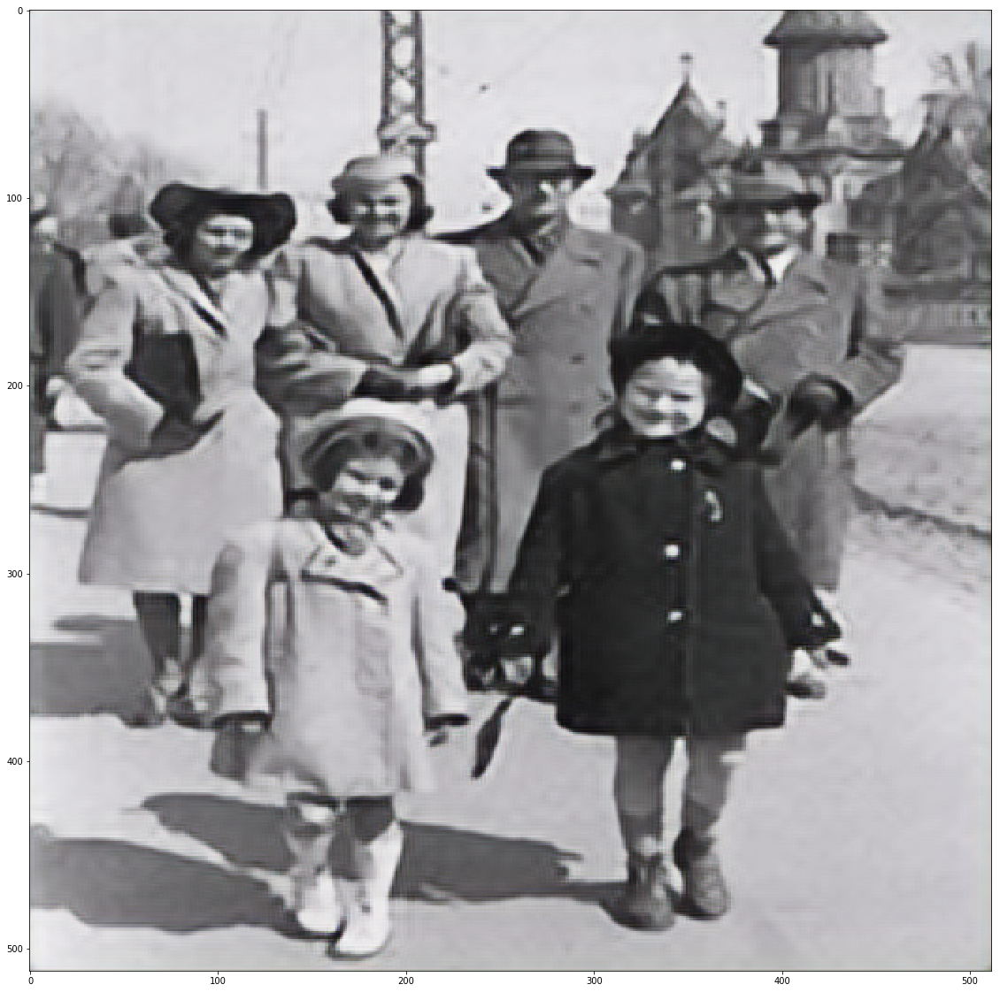

In [193]:
plt.figure(figsize=(20,20))
plt.imshow(p[0].astype('uint8'));

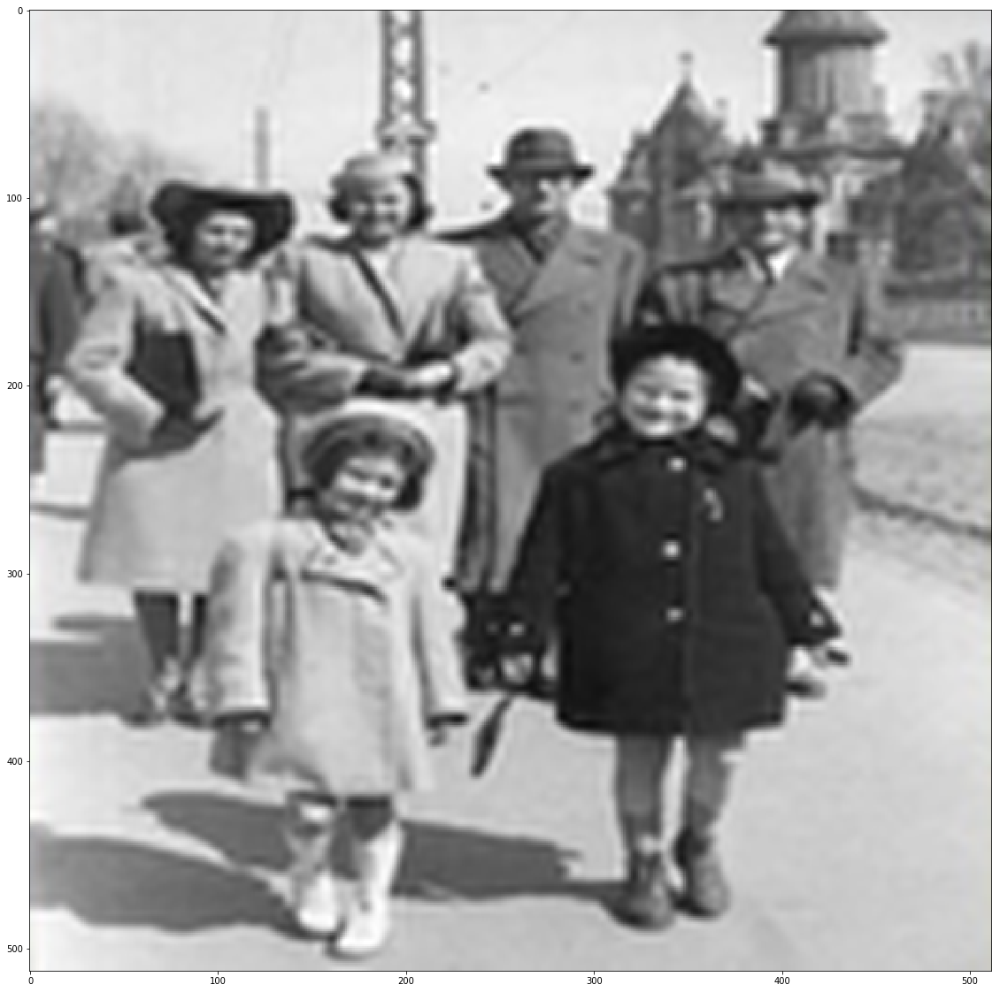

In [195]:
plt.figure(figsize=(20,20))
plt.imshow(img.resize((512,512),resample=Image.LANCZOS))

In [121]:
p_hr = model_test.predict(arr_hr[1002:1003].astype('uint8'))

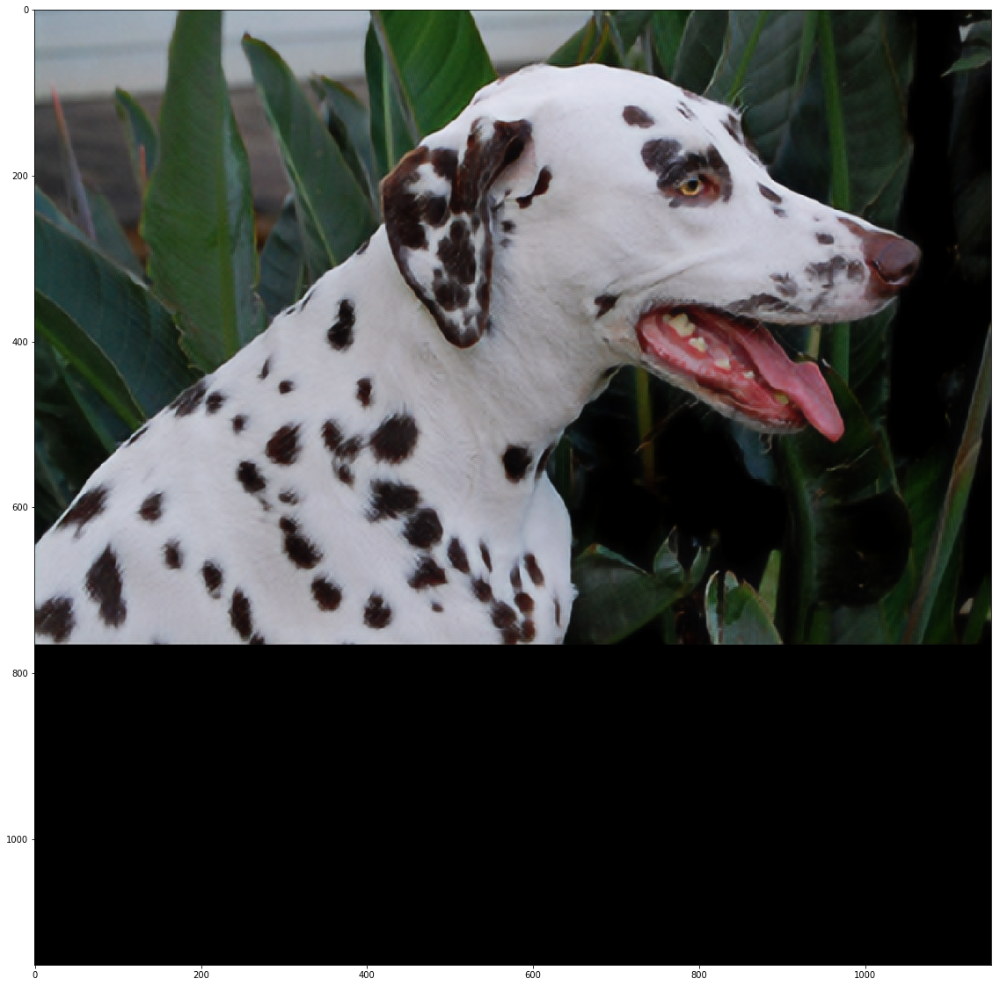

In [122]:
plt.figure(figsize=(20,20))
plt.imshow(p_hr[0].astype('uint8'));

In [138]:
print(np.mean(arr_hr[0]))
print(np.max(arr_hr[0]), np.min(arr_hr[0]))
print(np.mean(img_dat[0]))
print(np.max(img_dat[0]), np.min(img_dat[0]))

110.148
255.0 0.0
74.5728644226
255 0


# Acknowledgements 

paper + supplementary material + other sources of insight and figures:
    https://arxiv.org/pdf/1603.08155.pdf
    https://cs.stanford.edu/people/jcjohns/papers/eccv16/JohnsonECCV16Supplementary.pdf
    https://shafeentejani.github.io/2017-01-03/fast-style-transfer/
    https://shafeentejani.github.io/2016-12-27/style-transfer/
    https://distill.pub/2016/deconv-checkerboard/
    http://deeplearning.net/software/theano/tutorial/conv_arithmetic.html

prepared imagenet subset:
    http://files.fast.ai/data/trn_resized_288.tar.gz
    http://files.fast.ai/data/trn_resized_72.tar.gz

fast.ai sr lesson forum & wiki page:
    http://forums.fast.ai/t/lesson-9-wiki/1809
    http://forums.fast.ai/t/lesson-9-discussion/1627

base repo used for the code:
    https://github.com/jph00/part2